In [1]:
from py_tools import parse_dataset
from typing import List
import numpy as np

In [2]:
dataset = parse_dataset()

In [3]:
len(dataset.data)

40546

In [4]:
dataset.lasers[0].scan.shape[0]

180

In [5]:
a,b = dataset.lasers[0].XY
a.shape

(165,)

In [6]:
import matplotlib.pyplot as plt
from matplotlib import animation, rc
from IPython.display import display, Math, Latex, Markdown, HTML

# Some Visualization

## Laser Scans alone 

To test if we parsed the dataset correctly

In [9]:
def animate_lidar(lidar_scans: List['np.array'], xlim, ylim, frames, fps = 30):
    fig = plt.figure(figsize=(10, 6))
    anim_ax = fig.add_subplot(111)
    if xlim != None and ylim != None:
        anim_ax.set(xlim=xlim, ylim=ylim)
    anim_ax.set_aspect('equal')
    plt.close()
    x_laser, y_laser = lidar_scans[0]
    # Prepare Laser data.
    laser_line, = anim_ax.plot(x_laser, y_laser, 'o', color='orangered', markersize=3)

    def animate(i):
        start_frame = frames[1]
        skip_frames = frames[2]
        next_frame = start_frame + i*(skip_frames+1)
        laser = lidar_scans[next_frame]
        x_p, y_p = laser
        laser_line.set_data(x_p, y_p)
        return (laser_line,)
    
    anim = animation.FuncAnimation(fig, animate,
                                   frames=frames[1], # len(data.lasers)
                                   interval=500, 
                                   blit=True)
    return HTML(anim.to_jshtml(fps = fps))

In [10]:
lidar_scans = [scan.XY for scan in dataset.lasers]

In [11]:
# xlim=(-20,20), ylim=(-1,25)
animate_lidar(lidar_scans, xlim=(-20,20), ylim=(-1,25), frames=(150, 200, 5))

In [12]:
# maximum value of laser range:
laser_max_val = max([max(laser.scan) for laser in dataset.lasers])
laser_max_val 
# Lets assume readings larger than 70 meters are not valid

81.83

## Using the odometery alone to draw trajectory

In [13]:
def animate_path(path: 'np.array', xlim, ylim, frames, fps = 30):
    start_frame = frames[0]
    skip_frames = frames[2]
    fig = plt.figure(figsize=(10, 6))
    anim_ax = fig.add_subplot(111)
    if xlim != None and ylim != None:
        anim_ax.set(xlim=xlim, ylim=ylim)
    anim_ax.set_aspect('equal')
    plt.close()
    x_p, y_p = [path[0,0]], [path[1,0]]
    # Prepare Laser data.
    laser_line, = anim_ax.plot(x_p, y_p, '-', color='blue')
    
    def animate(i):
        end_frame = start_frame + i*(skip_frames+1)
        x_p, y_p = path[:, :end_frame]
        laser_line.set_data(x_p, y_p)
        return (laser_line,)
    
    anim = animation.FuncAnimation(fig, animate,
                                   frames=frames[1], # len(data.lasers)
                                   interval=500, 
                                   blit=True)
    return HTML(anim.to_jshtml(fps = fps))

In [14]:
path = np.array([np.array([scan.x, scan.y]).reshape(2,1) for scan in dataset.lasers]).squeeze().T
path.shape

(2, 13631)

In [15]:
animate_path(path, xlim=(-60,25), ylim=(-40,25), frames=(150, 200+30, int((len(dataset.lasers) - 150)/200 ) ))

## Map with only Odometry data

In [16]:
print(min([scan.theta for scan in dataset.lasers]), max([scan.theta for scan in dataset.lasers]))

-3.136677 3.140363


In [17]:
from math import sin, cos
def xyt_2_transofmation(x,y,theta):
    rotation = np.array([[cos(theta), sin(theta)],[-sin(theta), cos(theta)]])
    translation = np.array([[x],[y]], dtype = np.float)
    transformation = np.identity(3, dtype=np.float)
    transformation[:2,:2] = rotation
    transformation[:2,[2]] = translation
    return transformation

In [18]:
def toHomogeneous(matrix):
    shape = matrix.shape
    res = np.ones((shape[0]+1 , shape[1]), dtype=np.float)
    res[:shape[0],:] = matrix
    return res

In [19]:
laser = dataset.lasers[0]
laser.XY.shape

(2, 165)

In [21]:
point_cloud = []
for laser in dataset.lasers:
    transformation = xyt_2_transofmation(laser.x, laser.y, laser.theta)
    h = toHomogeneous(laser.XY)
    point_cloud.append(np.matmul(transformation, h)[:2,:]) 

In [20]:
h = toHomogeneous(laser.XY)
h.shape

(3, 165)

In [145]:
def animate_map(map_data: List['np.array'], lengths, xlim, ylim, frames, fps = 30):
    start_frame = frames[0]
    skip_frames = frames[2]
    fig = plt.figure(figsize=(10, 6))
    anim_ax = fig.add_subplot(111)
    if xlim != None and ylim != None:
        anim_ax.set(xlim=xlim, ylim=ylim)
    anim_ax.set_aspect('equal')
    plt.close()
    x_p, y_p = map_data[0]
    # Prepare Laser data.
    laser_line, = anim_ax.plot(x_p, y_p, '.', color='orangered', markersize=1, label = "0")
    
    map_data = np.concatenate(map_data, axis = 1)

    def animate(i):
        end_frame = start_frame + i*(skip_frames+1)
        this_start = max(end_frame-int(skip_frames*fps*0.75), 0)
        s = sum(lengths[:this_start])
        e = sum(lengths[:end_frame])  # end_frame*180
        x_p, y_p = map_data[:, s:e]
        laser_line.set_data(x_p, y_p)
        laser_line.set_label("{}:{}".format(this_start,end_frame))
        anim_ax.legend()
        return (laser_line,)
    
    anim = animation.FuncAnimation(fig, animate,
                                   frames=frames[1], # len(data.lasers)
                                   interval=500, 
                                   blit=True)
    return HTML(anim.to_jshtml(fps = fps))

In [147]:
skip = 1
animate_map(point_cloud, 
            lengths=dataset.length_lasers , 
            xlim=(-60,25), ylim=(-40,25), 
            frames=(150, 1000,  skip), 
            fps = 30)

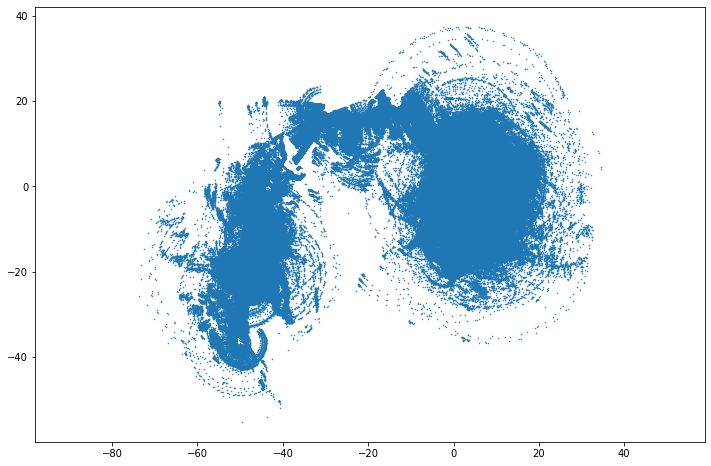

In [121]:
# Complete Map
def draw_complete_map(data):
    map_c = np.concatenate(data, axis = 1)
    x, y = map_c
    fig = plt.figure(figsize=(12, 8))
    ax = fig.add_subplot(111)
    ax.axis('equal')
    x_p, y_p = map_c
    ax.scatter(x_p, y_p, s=1, marker='.')
    return ax

draw_complete_map(point_cloud)

# Start the ICP

## Comparing only two scans

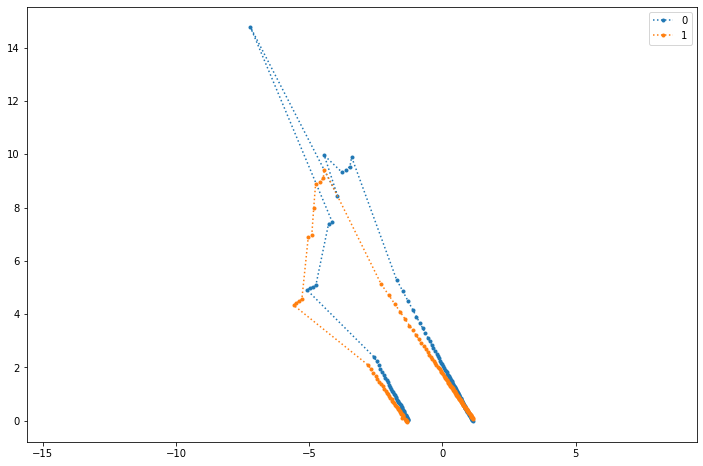

In [153]:
idx =  170
scans = [dataset.lasers[idx], dataset.lasers[idx + 1] ]

# Draw scans but in the first scan's frame after appplying the odom info to see the error of the odom alone
Ts = [xyt_2_transofmation(scan.x, scan.y, scan.theta) for scan in scans]

cloud = []
ref = Ts[0] #  reference frame
ref_inv = np.linalg.inv(ref) # inverse of reference frame
for scan, t in zip(scans, Ts):
    transformed_points = (ref_inv @ t).dot(toHomogeneous(scan.XY))
    cloud.append(transformed_points[:2,:])

def plot_data(data):
    fig = plt.figure(figsize=(12, 8))
    ax = fig.add_subplot(111)
    ax.axis('equal')
    for idx, d in enumerate(data):
        x_p, y_p = d
        ax.plot(x_p, y_p, markersize=3, marker='o', linestyle=":", label="{}".format(idx))
    ax.legend()
    return ax

plot_data(cloud)

In [183]:
import sys

def plot_data(data_1, data_2, label_1, label_2, markersize_1=3, markersize_2=3):
    fig = plt.figure(figsize=(20, 12))
    ax = fig.add_subplot(111)
    ax.axis('equal')
    if data_1 is not None:
        x_p, y_p = data_1
        ax.plot(x_p, y_p, color='#336699', markersize=markersize_1, marker='o', linestyle=":", label=label_1)
    if data_2 is not None:
        x_q, y_q = data_2
        ax.plot(x_q, y_q, color='orangered', markersize=markersize_2, marker='o', linestyle=":", label=label_2)
    ax.legend()
    return ax

def get_correspondence_indices(P, Q):
    """For each point in P find closest one in Q."""
    p_size = P.shape[1]
    q_size = Q.shape[1]
    correspondences = []
    for i in range(p_size):
        p_point = P[:, i]
        min_dist = sys.maxsize
        chosen_idx = -1
        for j in range(q_size):
            q_point = Q[:, j]
            dist = np.linalg.norm(q_point - p_point)
            if dist < min_dist:
                min_dist = dist
                chosen_idx = j
        correspondences.append((i, chosen_idx))
    return correspondences

def draw_correspondeces(P, Q, correspondences, ax):
    label_added = False
    for i, j in correspondences:
        x = [P[0, i], Q[0, j]]
        y = [P[1, i], Q[1, j]]
        if not label_added:
            ax.plot(x, y, color='grey', label='correpondences')
            label_added = True
        else:
            ax.plot(x, y, color='grey')
    ax.legend()

def plot_values(values, label):
    fig = plt.figure(figsize=(10, 4))
    ax = fig.add_subplot(111)
    ax.plot(values, label=label)
    ax.legend()
    ax.grid(True)
    plt.show()

def animate_results(P_values, Q, corresp_values, xlim, ylim):
    """A function used to animate the iterative processes we use."""
    fig = plt.figure(figsize=(20, 12))
    anim_ax = fig.add_subplot(111)
    anim_ax.set(xlim=xlim, ylim=ylim)
    anim_ax.set_aspect('equal')
    plt.close()
    x_q, y_q = Q
    # draw initial correspondeces
    corresp_lines = []
    for i, j in corresp_values[0]:
        corresp_lines.append(anim_ax.plot([], [], 'grey')[0])
    # Prepare Q data.
    Q_line, = anim_ax.plot(x_q, y_q, 'o', color='orangered')
    # prepare empty line for moved data
    P_line, = anim_ax.plot([], [], 'o', color='#336699')

    def animate(i):
        P_inc = P_values[i]
        x_p, y_p = P_inc
        P_line.set_data(x_p, y_p)
        draw_inc_corresp(P_inc, Q, corresp_values[i])
        return (P_line,)
    
    def draw_inc_corresp(points_from, points_to, correspondences):
        for corr_idx, (i, j) in enumerate(correspondences):
            x = [points_from[0, i], points_to[0, j]]
            y = [points_from[1, i], points_to[1, j]]
            corresp_lines[corr_idx].set_data(x, y)
    
    anim = animation.FuncAnimation(fig, animate,
                                   frames=len(P_values), 
                                   interval=500, 
                                   blit=True)
    return HTML(anim.to_jshtml())

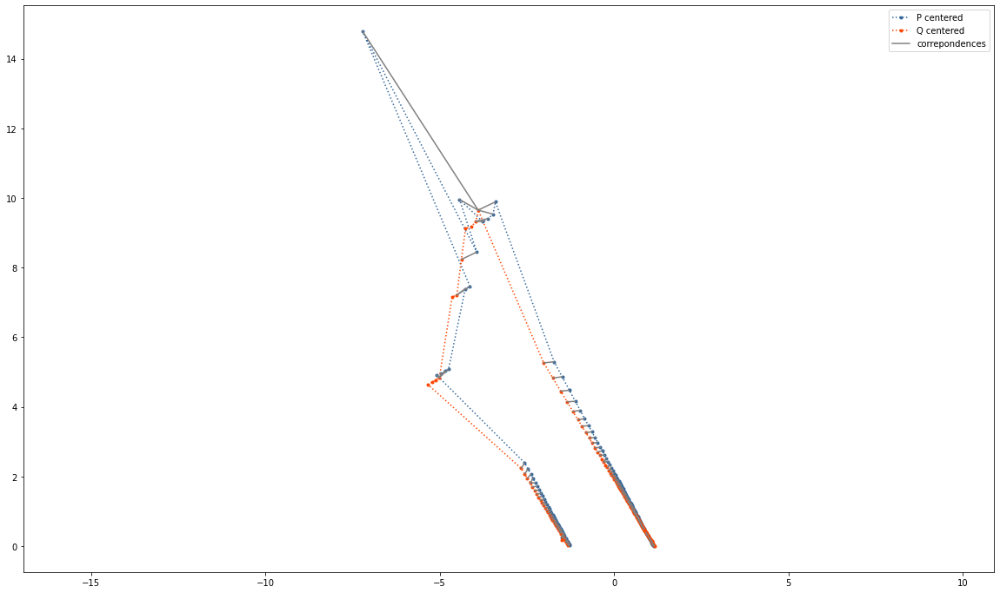

In [177]:
cor = get_correspondence_indices(scans[0].XY, scans[1].XY)
ax = plot_data(scans[0].XY, scans[1].XY,
               label_1='P centered',
               label_2='Q centered')
draw_correspondeces(scans[0].XY, scans[1].XY, cor, ax)
plt.show()

# Least Square

In [167]:
P, Q = scans[0].XY, scans[1].XY

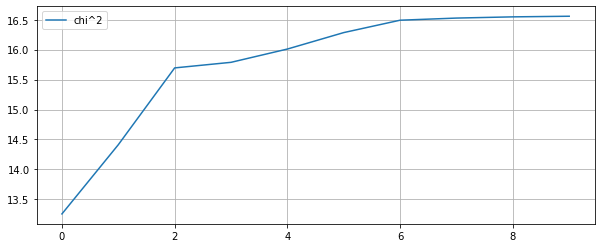

In [186]:
from math import sin, cos, atan2, pi
from functools import partial

def dR(theta):
    return np.array([[-sin(theta), -cos(theta)],
                     [cos(theta),  -sin(theta)]])

def R(theta):
    return np.array([[cos(theta), -sin(theta)],
                     [sin(theta),  cos(theta)]])

def jacobian(x, p_point):
    theta = x[2]
    J = np.zeros((2, 3))
    J[0:2, 0:2] = np.identity(2)
    J[0:2, [2]] = dR(0).dot(p_point)
    return J

def error(x, p_point, q_point):
    rotation = R(x[2])
    translation = x[0:2]
    prediction = rotation.dot(p_point) + translation
    return prediction - q_point

def prepare_system(x, P, Q, correspondences, kernel=lambda distance: 1.0):
    H = np.zeros((3, 3))
    g = np.zeros((3, 1))
    chi = 0
    for i, j in correspondences:
        p_point = P[:, [i]]
        q_point = Q[:, [j]]
        e = error(x, p_point, q_point)
        weight = kernel(e) # Please ignore this weight until you reach the end of the notebook.
        J = jacobian(x, p_point)
        H += weight * J.T.dot(J)
        g += weight * J.T.dot(e)
        chi += e.T * e
    return H, g, chi

def icp_least_squares(P, Q, iterations=10, kernel=lambda distance: 1.0):
    x = np.zeros((3, 1))
    chi_values = []
    x_values = [x.copy()]  # Initial value for transformation.
    P_values = [P.copy()]
    P_copy = P.copy()
    corresp_values = []
    for i in range(iterations):
        rot = R(x[2])
        t = x[0:2]
        correspondences = get_correspondence_indices(P_copy, Q)
        corresp_values.append(correspondences)
        H, g, chi = prepare_system(x, P, Q, correspondences, kernel)
        dx = np.linalg.lstsq(H, -g, rcond=None)[0]
        x += dx
        x[2] = atan2(sin(x[2]), cos(x[2])) # normalize angle
        chi_values.append(chi.item(0))
        x_values.append(x.copy())
        rot = R(x[2])
        t = x[0:2]
        P_copy = rot.dot(P.copy()) + t
        P_values.append(P_copy)
    corresp_values.append(corresp_values[-1])
    return P_values, chi_values, corresp_values

def kernel(threshold, error):
    if np.linalg.norm(error) < threshold:
        return 1.0
    return 0.0

P_values, chi_values, corresp_values = icp_least_squares(P, Q, kernel=partial(kernel, 2))
plot_values(chi_values, label="chi^2")

In [187]:
animate_results(P_values, Q, corresp_values, xlim=(-12,12), ylim=(-1,12))